## Embedding

### Create a dense BQM

In [1]:
import dwave_utils.utils as dwu 

bqm = dwu.random_dense_bqm(5)

## Embedding experiments on the QPU
### We are going to explore different embedding options that dwu provides

In [2]:
new_bqm, emb = dwu.embedded_bqm(bqm, 
                                target='advantage',      # Advantage QPU
                                chain_strength=None,     # use the default uniform_torque_compensation
                                clique = False,          # do not use minorminer clique embedding
                                return_embedding=True)   # also return the embedding graph

### Let's get some info about this new BQM and also the embedding performed:

In [3]:
dwu.compare_bqm(bqm,new_bqm,emb)

Old BQM var:  5 
New BQM var:  6 
Extra qubits needed:  1
Old BQM connectivity:  1.0 
New BQM connectivity:  0.7333333333333333
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  5


{'min_chain': 1,
 'max_chain': 2,
 'total_chain': 5,
 'old_var': 5,
 'new_var': 6,
 'extra_qubits': 1,
 'old_connectivity': 1.0,
 'new_connectivity': 0.7333333333333333}

### Embed on D-Wave 2000Q QPU:

In [4]:
new_bqm_2000, emb_2000 = dwu.embedded_bqm(bqm, 
                                          target='2000',           # 2000 QPU
                                          chain_strength=None,     # use the default uniform_torque_compensation
                                          clique = False,          # do not use minorminer clique embedding
                                          return_embedding=True)   # also return the embedding graph

In [5]:
print("compare with unembedded BQM: ", dwu.compare_bqm(bqm,new_bqm_2000,emb))
print()
print("compare Advantage and 2000Q embedded BQMs: ", dwu.compare_bqm(new_bqm,new_bqm_2000,emb))


Old BQM var:  5 
New BQM var:  8 
Extra qubits needed:  3
Old BQM connectivity:  1.0 
New BQM connectivity:  0.5714285714285714
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  5
compare with unembedded BQM:  {'min_chain': 1, 'max_chain': 2, 'total_chain': 5, 'old_var': 5, 'new_var': 8, 'extra_qubits': 3, 'old_connectivity': 1.0, 'new_connectivity': 0.5714285714285714}

Old BQM var:  6 
New BQM var:  8 
Extra qubits needed:  2
Old BQM connectivity:  0.7333333333333333 
New BQM connectivity:  0.5714285714285714
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  5
compare Advantage and 2000Q embedded BQMs:  {'min_chain': 1, 'max_chain': 2, 'total_chain': 5, 'old_var': 6, 'new_var': 8, 'extra_qubits': 2, 'old_connectivity': 0.7333333333333333, 'new_connectivity': 0.5714285714285714}


### There is a function for that! Comparing straight away Advantage and 2000Q

In [6]:
dwu.compare_solvers(bqm)

advantage
Old BQM var:  5 
New BQM var:  6 
Extra qubits needed:  1
Old BQM connectivity:  1.0 
New BQM connectivity:  0.7333333333333333
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  5

 2000
Old BQM var:  5 
New BQM var:  8 
Extra qubits needed:  3
Old BQM connectivity:  1.0 
New BQM connectivity:  0.5714285714285714
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  5


({'min_chain': 1,
  'max_chain': 2,
  'total_chain': 5,
  'old_var': 5,
  'new_var': 6,
  'extra_qubits': 1,
  'old_connectivity': 1.0,
  'new_connectivity': 0.7333333333333333},
 {'min_chain': 1,
  'max_chain': 2,
  'total_chain': 5,
  'old_var': 5,
  'new_var': 8,
  'extra_qubits': 3,
  'old_connectivity': 1.0,
  'new_connectivity': 0.5714285714285714})

### These embeddings are ready for QA computation. We can also use "chimera", "pegasus" embeddings to find out more properties about the BQM. We can also testthe new zephyr architecture

### I want to see how the clique embedding performs on a dense BQM

In [7]:
report_adv = []
c_report_adv = []
report_2000 = []
c_report_2000 = []
report_zephyr = []
i_2000 = 60
for i in range(2,70): 
    bqm = dwu.random_dense_bqm(i)
    print('size: ',i)    
 
    if i < i_2000:
        print("dwave 2000: ")
        _2000_bqm, _2000_emb = dwu.embedded_bqm(bqm, 
                                    target='chimera',        
                                    chain_strength=None,     
                                    clique = False,
                                    return_embedding=True) 
        rep_2000 = dwu.compare_bqm(bqm, _2000_bqm, _2000_emb)

        c_2000_bqm, c_2000_emb = dwu.embedded_bqm(bqm, 
                                                  target='chimera',        
                                                  chain_strength=None,     
                                                  clique = True,
                                                  return_embedding=True) 
        c_rep_2000 = dwu.compare_bqm(bqm, c_2000_bqm, c_2000_emb)
    
    print("advantage: ")
    adv_bqm, adv_emb = dwu.embedded_bqm(bqm, 
                                            target='pegasus',        
                                            chain_strength=None,     
                                            clique = False,
                                           return_embedding=True) 
    rep_adv = dwu.compare_bqm(bqm, adv_bqm, adv_emb)


    c_adv_bqm, c_adv_emb = dwu.embedded_bqm(bqm, 
                                            target='pegasus',        
                                            chain_strength=None,     
                                            clique = True,
                                            return_embedding=True) 
    c_rep_adv = dwu.compare_bqm(bqm, c_adv_bqm, c_adv_emb)

    print("zephyr: ")
    zephyr_bqm, zephyr_emb = dwu.embedded_bqm(bqm, 
                                  target='zephyr',        
                                  chain_strength=None,     
                                  clique = False,
                                  return_embedding=True)     
    rep_zephyr = dwu.compare_bqm(bqm, zephyr_bqm, zephyr_emb)
    print()
    report_adv.append(rep_adv)
    c_report_adv.append(c_rep_adv)
    report_2000.append(rep_2000)
    c_report_2000.append(c_rep_2000)
    report_zephyr.append(rep_zephyr)

size:  2
dwave 2000: 
Old BQM var:  2 
New BQM var:  2 
Extra qubits needed:  0
Old BQM connectivity:  1.0 
New BQM connectivity:  1.0
Shortest chain is:  1
Longest chain is:  1
Total num of chain is:  2
Old BQM var:  2 
New BQM var:  2 
Extra qubits needed:  0
Old BQM connectivity:  1.0 
New BQM connectivity:  1.0
Shortest chain is:  1
Longest chain is:  1
Total num of chain is:  2
advantage: 
Old BQM var:  2 
New BQM var:  2 
Extra qubits needed:  0
Old BQM connectivity:  1.0 
New BQM connectivity:  1.0
Shortest chain is:  1
Longest chain is:  1
Total num of chain is:  2
Old BQM var:  2 
New BQM var:  2 
Extra qubits needed:  0
Old BQM connectivity:  1.0 
New BQM connectivity:  1.0
Shortest chain is:  1
Longest chain is:  1
Total num of chain is:  2
zephyr: 
Old BQM var:  2 
New BQM var:  2 
Extra qubits needed:  0
Old BQM connectivity:  1.0 
New BQM connectivity:  1.0
Shortest chain is:  1
Longest chain is:  1
Total num of chain is:  2

size:  3
dwave 2000: 
Old BQM var:  3 
New BQM

Old BQM var:  10 
New BQM var:  16 
Extra qubits needed:  6
Old BQM connectivity:  1.0 
New BQM connectivity:  0.5
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  10
Old BQM var:  10 
New BQM var:  20 
Extra qubits needed:  10
Old BQM connectivity:  1.0 
New BQM connectivity:  0.3894736842105263
Shortest chain is:  2
Longest chain is:  2
Total num of chain is:  10
zephyr: 
Old BQM var:  10 
New BQM var:  17 
Extra qubits needed:  7
Old BQM connectivity:  1.0 
New BQM connectivity:  0.5588235294117647
Shortest chain is:  1
Longest chain is:  2
Total num of chain is:  10

size:  11
dwave 2000: 
Old BQM var:  11 
New BQM var:  41 
Extra qubits needed:  30
Old BQM connectivity:  1.0 
New BQM connectivity:  0.11341463414634147
Shortest chain is:  3
Longest chain is:  4
Total num of chain is:  11
Old BQM var:  11 
New BQM var:  44 
Extra qubits needed:  33
Old BQM connectivity:  1.0 
New BQM connectivity:  0.10887949260042283
Shortest chain is:  4
Longest chain is:  4
Tota

Old BQM var:  18 
New BQM var:  48 
Extra qubits needed:  30
Old BQM connectivity:  1.0 
New BQM connectivity:  0.20035460992907803
Shortest chain is:  2
Longest chain is:  3
Total num of chain is:  18
Old BQM var:  18 
New BQM var:  54 
Extra qubits needed:  36
Old BQM connectivity:  1.0 
New BQM connectivity:  0.16561844863731656
Shortest chain is:  3
Longest chain is:  3
Total num of chain is:  18
zephyr: 
Old BQM var:  18 
New BQM var:  39 
Extra qubits needed:  21
Old BQM connectivity:  1.0 
New BQM connectivity:  0.2941970310391363
Shortest chain is:  1
Longest chain is:  3
Total num of chain is:  18

size:  19
dwave 2000: 
Old BQM var:  19 
New BQM var:  111 
Extra qubits needed:  92
Old BQM connectivity:  1.0 
New BQM connectivity:  0.045372645372645376
Shortest chain is:  5
Longest chain is:  7
Total num of chain is:  19
Old BQM var:  19 
New BQM var:  114 
Extra qubits needed:  95
Old BQM connectivity:  1.0 
New BQM connectivity:  0.04548983077161931
Shortest chain is:  6
Lon

Old BQM var:  26 
New BQM var:  94 
Extra qubits needed:  68
Old BQM connectivity:  1.0 
New BQM connectivity:  0.11370395790436971
Shortest chain is:  3
Longest chain is:  5
Total num of chain is:  26
Old BQM var:  26 
New BQM var:  98 
Extra qubits needed:  72
Old BQM connectivity:  1.0 
New BQM connectivity:  0.101620029455081
Shortest chain is:  3
Longest chain is:  4
Total num of chain is:  26
zephyr: 
Old BQM var:  26 
New BQM var:  77 
Extra qubits needed:  51
Old BQM connectivity:  1.0 
New BQM connectivity:  0.16985645933014354
Shortest chain is:  2
Longest chain is:  4
Total num of chain is:  26

size:  27
dwave 2000: 
Old BQM var:  27 
New BQM var:  248 
Extra qubits needed:  221
Old BQM connectivity:  1.0 
New BQM connectivity:  0.020961211962909756
Shortest chain is:  7
Longest chain is:  12
Total num of chain is:  27
Old BQM var:  27 
New BQM var:  216 
Extra qubits needed:  189
Old BQM connectivity:  1.0 
New BQM connectivity:  0.024935400516795866
Shortest chain is:  8


Old BQM var:  34 
New BQM var:  157 
Extra qubits needed:  123
Old BQM connectivity:  1.0 
New BQM connectivity:  0.07145190266209374
Shortest chain is:  3
Longest chain is:  6
Total num of chain is:  34
Old BQM var:  34 
New BQM var:  164 
Extra qubits needed:  130
Old BQM connectivity:  1.0 
New BQM connectivity:  0.06149932664970822
Shortest chain is:  4
Longest chain is:  5
Total num of chain is:  34
zephyr: 
Old BQM var:  34 
New BQM var:  135 
Extra qubits needed:  101
Old BQM connectivity:  1.0 
New BQM connectivity:  0.10403537866224434
Shortest chain is:  3
Longest chain is:  6
Total num of chain is:  34

size:  35
dwave 2000: 
Old BQM var:  35 
New BQM var:  411 
Extra qubits needed:  376
Old BQM connectivity:  1.0 
New BQM connectivity:  0.012806361640258739
Shortest chain is:  8
Longest chain is:  16
Total num of chain is:  35
Old BQM var:  35 
New BQM var:  350 
Extra qubits needed:  315
Old BQM connectivity:  1.0 
New BQM connectivity:  0.01573475235366353
Shortest chain 

Old BQM var:  42 
New BQM var:  245 
Extra qubits needed:  203
Old BQM connectivity:  1.0 
New BQM connectivity:  0.047775175644028105
Shortest chain is:  4
Longest chain is:  8
Total num of chain is:  42
Old BQM var:  42 
New BQM var:  202 
Extra qubits needed:  160
Old BQM connectivity:  1.0 
New BQM connectivity:  0.058667060735924335
Shortest chain is:  4
Longest chain is:  5
Total num of chain is:  42
zephyr: 
Old BQM var:  42 
New BQM var:  194 
Extra qubits needed:  152
Old BQM connectivity:  1.0 
New BQM connectivity:  0.07622456065381122
Shortest chain is:  3
Longest chain is:  7
Total num of chain is:  42

size:  43
dwave 2000: 
Old BQM var:  43 
New BQM var:  591 
Extra qubits needed:  548
Old BQM connectivity:  1.0 
New BQM connectivity:  0.00915426309902779
Shortest chain is:  11
Longest chain is:  18
Total num of chain is:  43
Old BQM var:  43 
New BQM var:  516 
Extra qubits needed:  473
Old BQM connectivity:  1.0 
New BQM connectivity:  0.010830134718145555
Shortest cha

Old BQM var:  50 
New BQM var:  316 
Extra qubits needed:  266
Old BQM connectivity:  1.0 
New BQM connectivity:  0.03849708659835242
Shortest chain is:  5
Longest chain is:  9
Total num of chain is:  50
Old BQM var:  50 
New BQM var:  290 
Extra qubits needed:  240
Old BQM connectivity:  1.0 
New BQM connectivity:  0.04016227180527383
Shortest chain is:  5
Longest chain is:  6
Total num of chain is:  50
zephyr: 
Old BQM var:  50 
New BQM var:  287 
Extra qubits needed:  237
Old BQM connectivity:  1.0 
New BQM connectivity:  0.054823225554932874
Shortest chain is:  4
Longest chain is:  9
Total num of chain is:  50

size:  51
dwave 2000: 
Old BQM var:  51 
New BQM var:  932 
Extra qubits needed:  881
Old BQM connectivity:  1.0 
New BQM connectivity:  0.005801597801985036
Shortest chain is:  13
Longest chain is:  25
Total num of chain is:  51
Old BQM var:  51 
New BQM var:  714 
Extra qubits needed:  663
Old BQM connectivity:  1.0 
New BQM connectivity:  0.007908352681886218
Shortest cha

Old BQM var:  58 
New BQM var:  399 
Extra qubits needed:  341
Old BQM connectivity:  1.0 
New BQM connectivity:  0.031221269253535848
Shortest chain is:  5
Longest chain is:  9
Total num of chain is:  58
Old BQM var:  58 
New BQM var:  396 
Extra qubits needed:  338
Old BQM connectivity:  1.0 
New BQM connectivity:  0.029075565784426542
Shortest chain is:  6
Longest chain is:  7
Total num of chain is:  58
zephyr: 
Old BQM var:  58 
New BQM var:  357 
Extra qubits needed:  299
Old BQM connectivity:  1.0 
New BQM connectivity:  0.044739244012211625
Shortest chain is:  4
Longest chain is:  9
Total num of chain is:  58

size:  59
dwave 2000: 
Old BQM var:  59 
New BQM var:  1187 
Extra qubits needed:  1128
Old BQM connectivity:  1.0 
New BQM connectivity:  0.004593040683855881
Shortest chain is:  15
Longest chain is:  28
Total num of chain is:  59
Old BQM var:  59 
New BQM var:  944 
Extra qubits needed:  885
Old BQM connectivity:  1.0 
New BQM connectivity:  0.006027913079425562
Shortest

KeyboardInterrupt: embedding cancelled by keyboard interrupt

### Plot the connectivity of the embedding as function of original qubits

<AxesSubplot:>

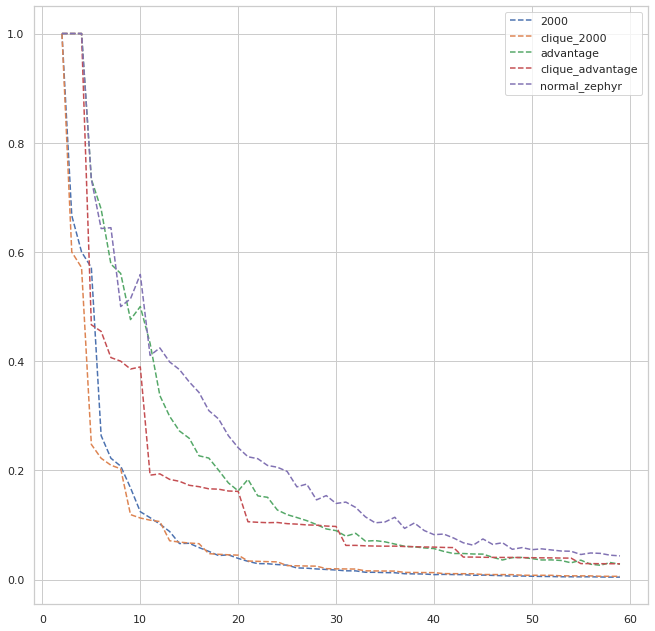

In [18]:
import seaborn as sns
import matplotlib.pyplot as plt

x = [_ for _ in range(2,i+1)]
x_2000 = [_ for _ in range(2,i_2000+1)]
y1 = [d['new_connectivity'] for d in report_2000]
y2 = [d['new_connectivity'] for d in c_report_2000]
y3 = [d['new_connectivity'] for d in report_adv]
y4 = [d['new_connectivity'] for d in c_report_adv]
y5 = [d['new_connectivity'] for d in report_zephyr]
size=11
fig, ax = plt.subplots(figsize = (size,size))

sns.lineplot(x=x_2000,y=y1,linestyle='dashed',label='2000')
sns.lineplot(x=x_2000,y=y2,linestyle='dashed',label='clique_2000')
sns.lineplot(x=x,y=y3,linestyle='dashed',label='advantage')
sns.lineplot(x=x,y=y4,linestyle='dashed',label='clique_advantage')
sns.lineplot(x=x,y=y5,linestyle='dashed',label='normal_zephyr')

### Plot the number of necessary additional qubits as function of original qubits

<AxesSubplot:>

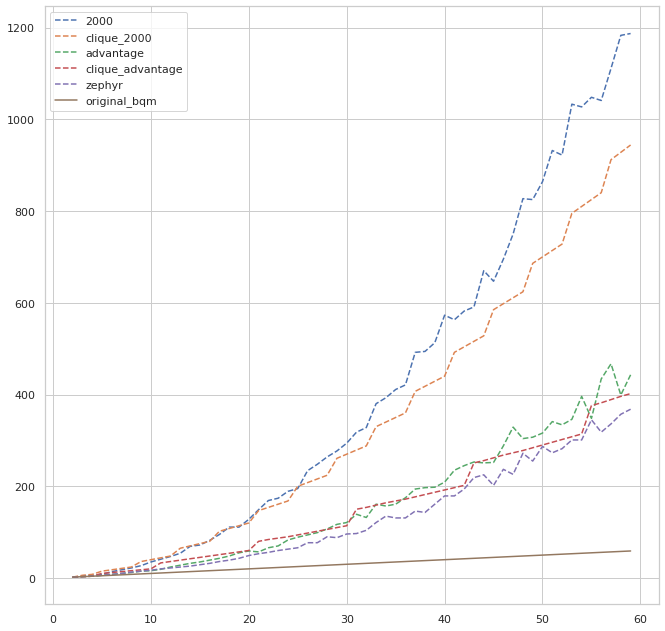

In [19]:
import seaborn as sns
import matplotlib.pyplot as plt

y1 = [d['new_var'] for d in report_2000]
y2 = [d['new_var'] for d in c_report_2000]
y3 = [d['new_var'] for d in report_adv]
y4 = [d['new_var'] for d in c_report_adv]
y5 = [d['new_var'] for d in report_zephyr]
y6 = [d['old_var'] for d in c_report_adv]
size=11
fig, ax = plt.subplots(figsize = (size,size))

sns.lineplot(x=x_2000,y=y1,linestyle='dashed',label='2000')
sns.lineplot(x=x_2000,y=y2,linestyle='dashed',label='clique_2000')
sns.lineplot(x=x,y=y3,linestyle='dashed',label='advantage')
sns.lineplot(x=x,y=y4,linestyle='dashed',label='clique_advantage')
sns.lineplot(x=x,y=y5,linestyle='dashed',label='zephyr')
sns.lineplot(x=x,y=y6,label='original_bqm')

## Plot minimum and maximum length of chains

<AxesSubplot:>

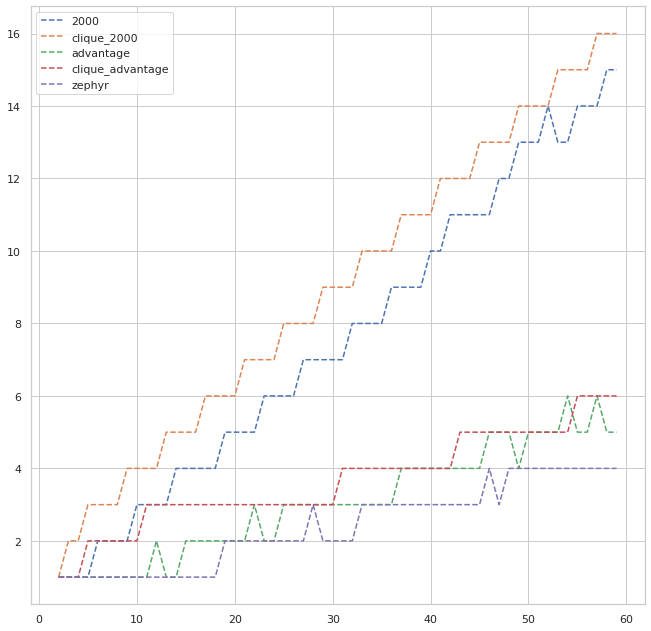

In [20]:
import seaborn as sns
import matplotlib.pyplot as plt

y1 = [d['min_chain'] for d in report_2000]
y2 = [d['min_chain'] for d in c_report_2000]
y3 = [d['min_chain'] for d in report_adv]
y4 = [d['min_chain'] for d in c_report_adv]
y5 = [d['min_chain'] for d in report_zephyr]
size=11
fig, ax = plt.subplots(figsize = (size,size))

sns.lineplot(x=x_2000,y=y1,linestyle='dashed',label='2000')
sns.lineplot(x=x_2000,y=y2,linestyle='dashed',label='clique_2000')
sns.lineplot(x=x,y=y3,linestyle='dashed',label='advantage')
sns.lineplot(x=x,y=y4,linestyle='dashed',label='clique_advantage')
sns.lineplot(x=x,y=y5,linestyle='dashed',label='zephyr')

<AxesSubplot:>

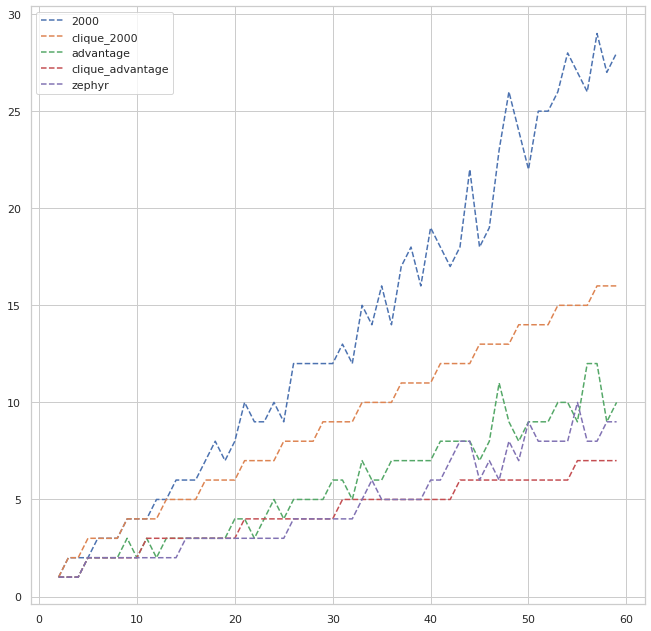

In [21]:
import seaborn as sns
import matplotlib.pyplot as plt

y1 = [d['max_chain'] for d in report_2000]
y2 = [d['max_chain'] for d in c_report_2000]
y3 = [d['max_chain'] for d in report_adv]
y4 = [d['max_chain'] for d in c_report_adv]
y5 = [d['max_chain'] for d in report_zephyr]
size=11
fig, ax = plt.subplots(figsize = (size,size))

sns.lineplot(x=x_2000,y=y1,linestyle='dashed',label='2000')
sns.lineplot(x=x_2000,y=y2,linestyle='dashed',label='clique_2000')
sns.lineplot(x=x,y=y3,linestyle='dashed',label='advantage')
sns.lineplot(x=x,y=y4,linestyle='dashed',label='clique_advantage')
sns.lineplot(x=x,y=y5,linestyle='dashed',label='zephyr')

## The chain scenario is better investigated in its distribution, with each chain length with the corresponding occurrence

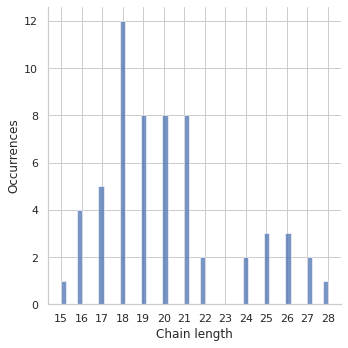

In [22]:
dwu.chain_histogram(_2000_emb)

### You can also easily visualize the embeddings

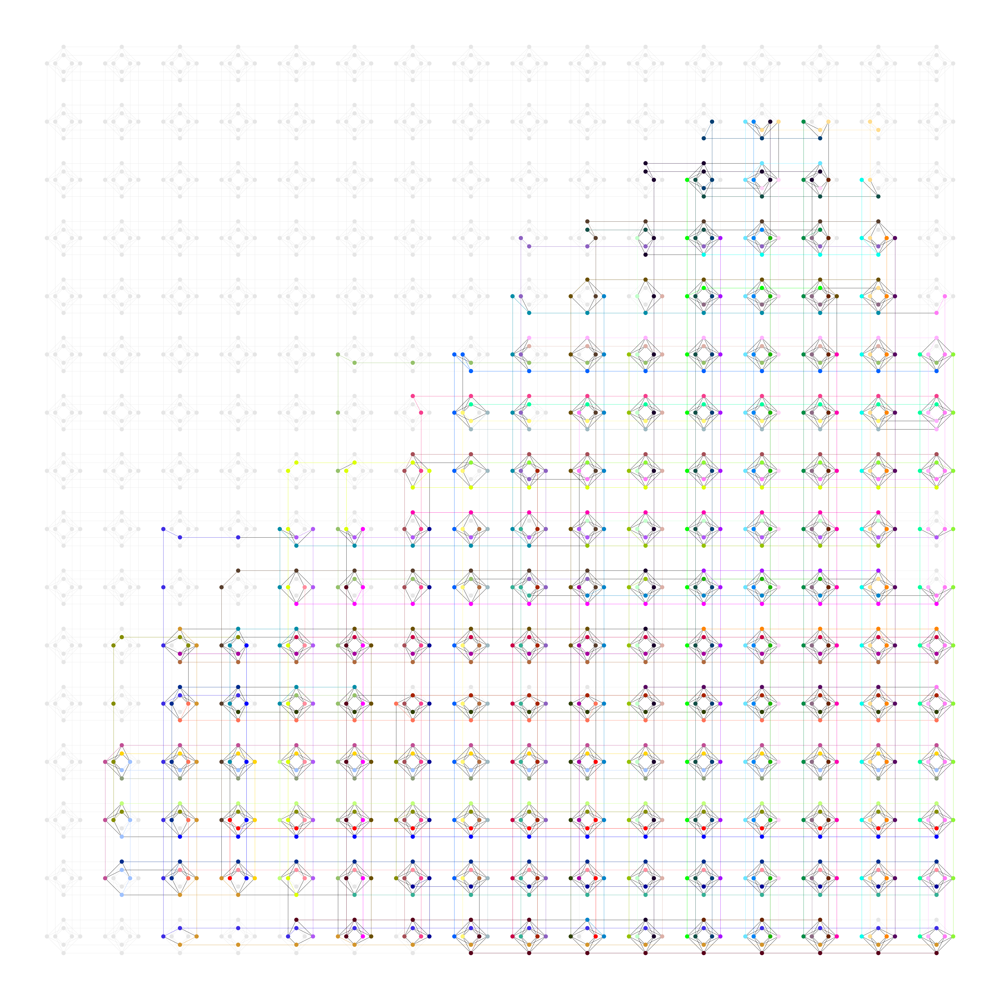

In [15]:
# DWave 2000Q

import dwave_networkx as dnx
plt.figure(figsize=(60.96,60.96))
chimera_graph = dnx.chimera_graph(16)
dnx.draw_chimera_embedding(chimera_graph, _2000_emb)

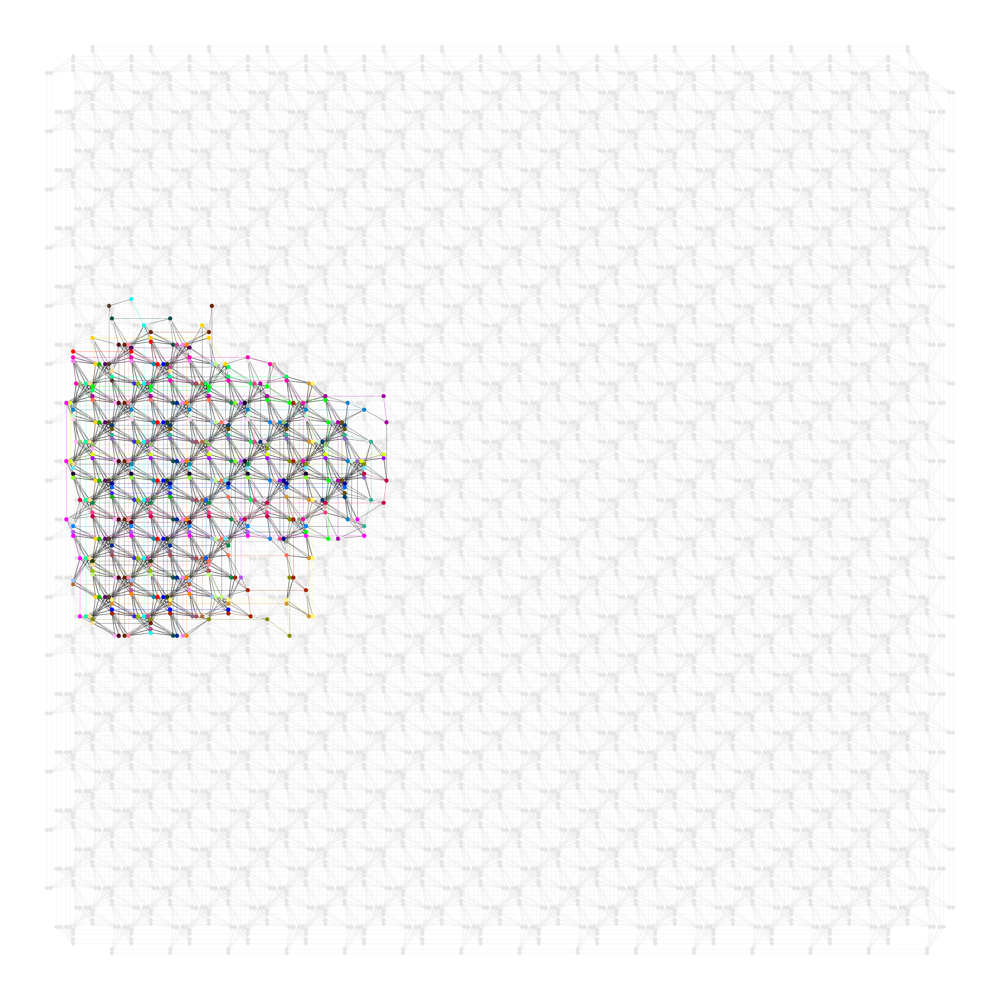

In [16]:
# Advantage

plt.figure(figsize=(60.96,60.96))
pegasus_graph = dnx.pegasus_graph(16)
dnx.draw_pegasus_embedding(pegasus_graph, adv_emb)

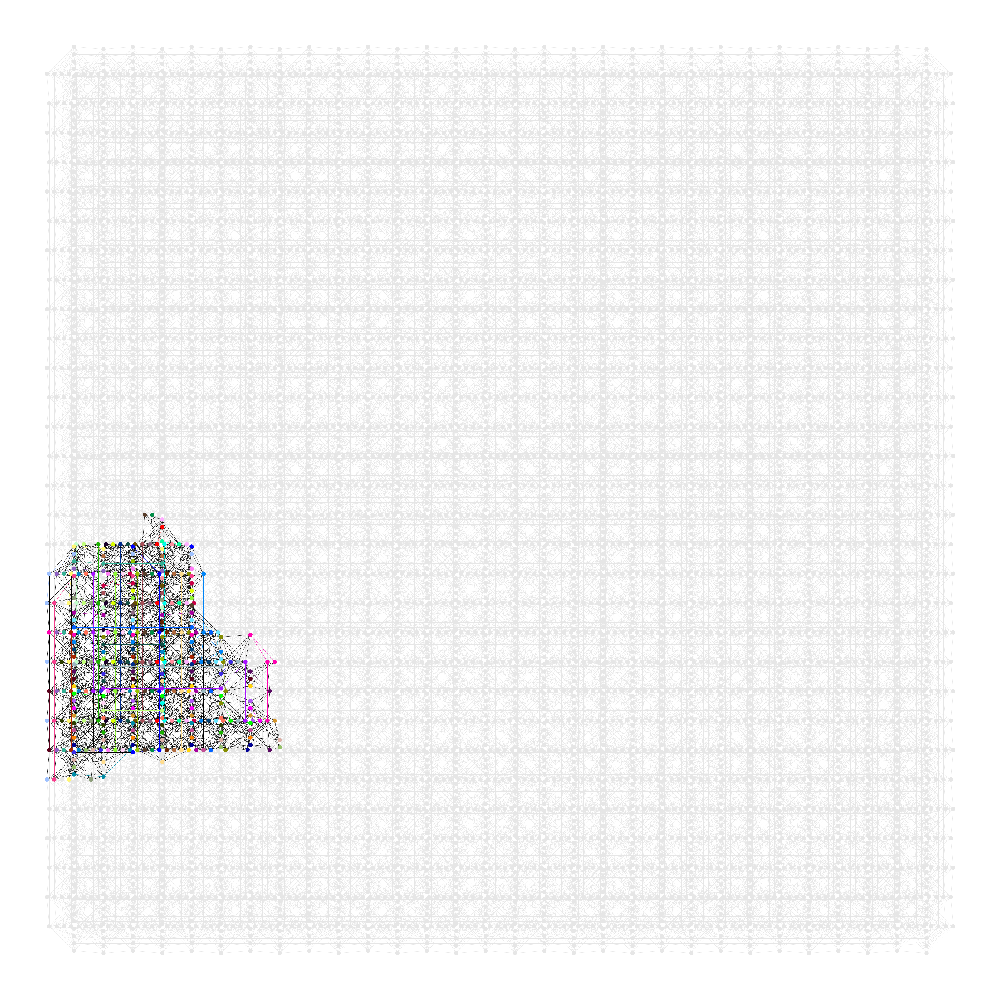

In [17]:
# Zephyr

plt.figure(figsize=(60.96,60.96))
zephyr_graph = dnx.zephyr_graph(15)
dnx.draw_zephyr_embedding(zephyr_graph, zephyr_emb)